# Intro
This notebook is used to generate a labeled dataset drived from a geojson file. The dataset will be an image with a size of a given radius and associated binary mask of the same size. The dimention of the generated dataset is approximate and during training you are expected to resize or crop the image to exactly match the desired size.

## Installing packages

In [1]:
!pip install -q geemap
!pip install -q retry
!pip install -q rasterio
!pip install -q shapely
!pip install -q geopandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 67.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.5/130.5 kB 10.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 74.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 66.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 30.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 55.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 37.6 MB/s eta 0:00:00
   

## Importing Libraries

In [83]:
import ee
import rasterio
import numpy as np
from rasterio.windows import Window
import time
import pandas as pd
import matplotlib.pyplot as plt
from osgeo import gdal
import os
from os.path import isfile, join
import geopandas as gpd
from rasterio.features import geometry_mask
import os
import pyarrow as pa
import pyarrow.parquet as pq
import json
from shapely.geometry import shape, MultiPolygon
from google.colab import drive

## Setup GEE and Drive
You need to connect to GEE to download satellite images and to Google Drive to retrive those satellite images and other files.

In [ ]:
drive.mount('/content/drive')

# Authenticate to the Earth Engine servers
try:
    ee.Initialize()
except Exception as e:
    ee.Authenticate()
    ee.Initialize()

# Download Geojsons Data
Downloading the geojsons data which is a label produced by our team. You will need to change the directory to reflect your working directory.

In [3]:
!cp -nr /content/drive/MyDrive/GreenGuardians/data/geojsons .

# Find the Center
Here we are calculating the center of the labled data and then we will use it later to download the data from GEE.

In [54]:
geojson_dir = '/content/geojsons/'

locations = []
for file_name in os.listdir(geojson_dir):
    if '.geojson' in file_name:
        # Load GeoJSON file
        with open(geojson_dir+file_name) as f:
            data = json.load(f)

        # Parse features
        all_shapes = []
        for feature in data['features']:
            geom = feature['geometry']
            all_shapes.append(shape(geom))

        # If multiple shapes, make a multipolygon
        multi = MultiPolygon(all_shapes)

        # Get centroid of the shape
        centroid = multi.centroid
        locations.append([file_name, centroid])

# Download Image
For each center location, we download the satellite data. Modify the radius to get a different size image. It will take some time to download all images. You can optionally disable the export part if you already have the data and avoid a mistake of re-running it.

In [87]:
# You can disable exporting to avoid re-generting again and again
disable_export = True
radius = 129 * 10 # In meters. 1px is equivalent to 10 meters

In [89]:
# Removing clouds
def maskS2clouds(image):
  qa = image.select('QA60')

  # Bits 10 and 11 are clouds and cirrus, respectively.
  cloudBitMask = 1 << 10
  cirrusBitMask = 1 << 11

  # Both flags should be set to zero, indicating clear conditions.
  mask = qa.bitwiseAnd(cloudBitMask).eq(0) \
      .And(qa.bitwiseAnd(cirrusBitMask).eq(0))

  return image.updateMask(mask).divide(10000)

# Set image resolution
resolution = 10  # Sentinel-2 has a resolution of 10m for RGB bands

# You can disable exporting to avoid re-generting again and again
if not disable_export:
    for loc in locations:
        print(f"Processing {loc[0][:-8]} location.")
        point = ee.Geometry.Point([loc[1].x, loc[1].y])

        # Harmonized Sentinel-2 MSI: MultiSpectral Instrument, Level-2A
        image = ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED') \
                          .filterDate('2023-05-01', '2023-09-30') \
                          .filterBounds(point) \
                          .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',20)) \
                          .map(maskS2clouds).select('B4', 'B3', 'B2', 'B8').median()

        # Define the export parameters
        task_config = {
            'image': image,
            'folder': f'GEE_Boreal_{radius}',
            'description': f'LabeledBorealLoggingScars_{loc[0][:-8]}',
            'scale': resolution,
            'region': point.buffer(radius).bounds(), # Adding extra 1 meter buffer
            'maxPixels': 1e13
        }

        # Export the image to Google Drive
        task = ee.batch.Export.image.toDrive(**task_config)
        task.start()

        # Monitor the task
        while task.status()['state'] in ['READY', 'RUNNING']:
            print(task.status())
            time.sleep(15)
        else:
            print(task.status())

# Generate Dataset
We put together the satellite image and the labeled data in geojson format after converting it to a binary mask.

In [84]:
patch_remote_dir = f"/content/drive/MyDrive/GEE_Boreal_{radius}/"
patch_dir = f"/content/GEE_Boreal_{radius}/"
dataset_dir = "/content/dataset/"
dataset_image_dir = f"{dataset_dir}image/"
dataset_mask_dir = f"{dataset_dir}mask/"

!rm -rf {patch_dir}
!rm -rf {dataset_dir}
!cp -rn {patch_remote_dir} .

!mkdir -p {dataset_dir}
!mkdir -p {dataset_image_dir}
!mkdir -p {dataset_mask_dir}

# Reading the GeoJSON file for masks
data_files, polygons = [], []
for subdir, dirs, files in os.walk(geojson_dir):
    for f in files:
        if isfile(join(subdir, f)) and '.geojson' in f:
            data_files.append(join(subdir, f))
            gdf = gpd.read_file(join(subdir, f))
            for idx, row in gdf.iterrows():
                polygons.append(row.geometry)

# Reading the images
tile_files = []
for subdir, dirs, files in os.walk(patch_dir):
    for f in files:
        if isfile(join(subdir, f)) and '.tif' in f:
            tile_files.append(join(subdir, f))

# Generating a mask for each patch
for t in tile_files:
    # Load GeoTIFF file
    with rasterio.open(t) as src:
        # Create a mask
        mask = geometry_mask(
            geometries=polygons,
            out_shape=src.shape,
            transform=src.transform,
            invert=True
        )

        # Convert the mask from boolean to integer type
        mask = mask.astype(np.uint8)
        !cp {t} {dataset_image_dir}
        mask_file_name = os.path.basename(t)
        with rasterio.open(f"{dataset_mask_dir}{mask_file_name}", "w", driver="GTiff", height=src.height, width=src.width, count=1, dtype=rasterio.uint8, transform=src.transform) as dst:
            dst.write(mask.astype(rasterio.uint8), 1)

# Dataset View - ~256
An image with ~256px dimention

In [85]:
def loadTiff(in_image, max=-1):
    src = gdal.Open(in_image)
    nbands = src.RasterCount
    in_band = src.GetRasterBand(1)
    xinit, yinit = (0, 0)
    block_xsize, block_ysize = (in_band.XSize, in_band.YSize)
    # read the (multiband) file into an array
    image = src.ReadAsArray(xinit, yinit, block_xsize, block_ysize)
    if max != -1:
        for i in range(nbands):
          image[i] = np.clip(image[i]/max, 0, 1)
        # reshape from bandsxheightxwidth to wxhxb
        image = np.moveaxis(image, 0, -1)
    return image, block_ysize, block_xsize, nbands

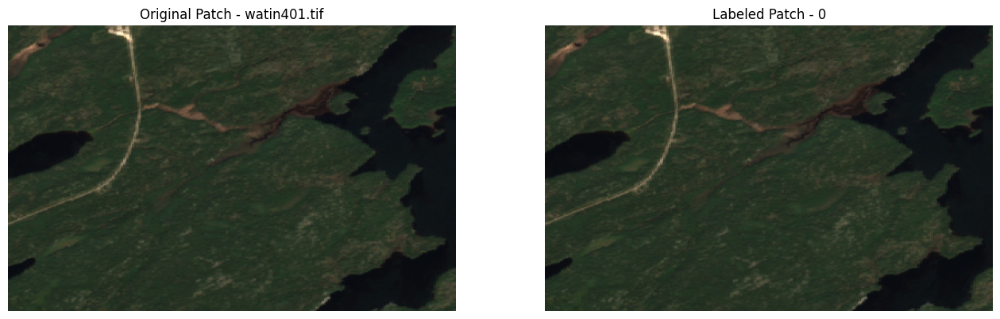

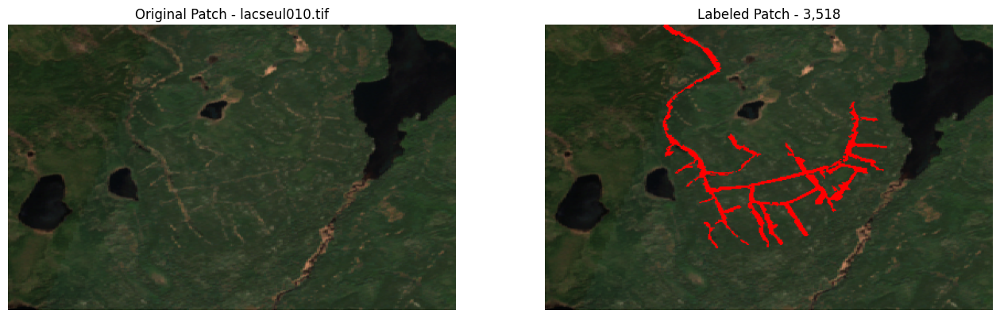

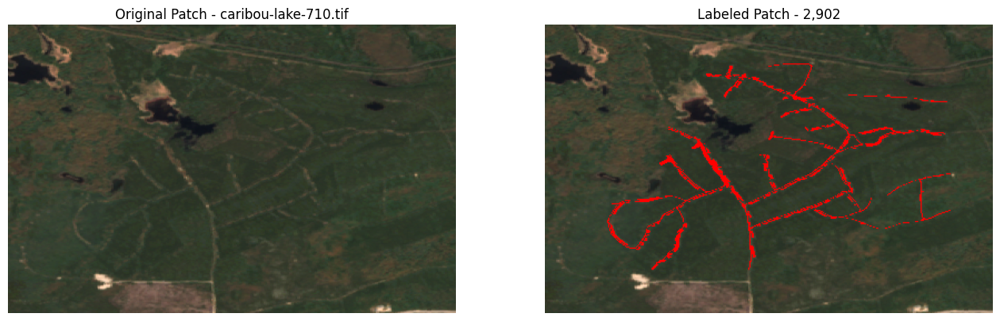

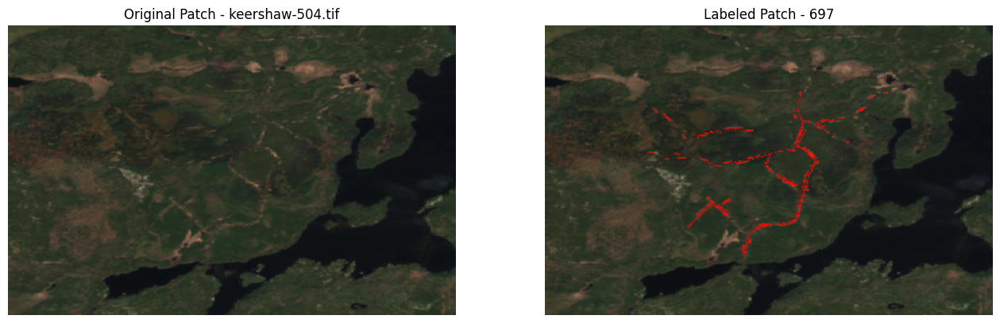

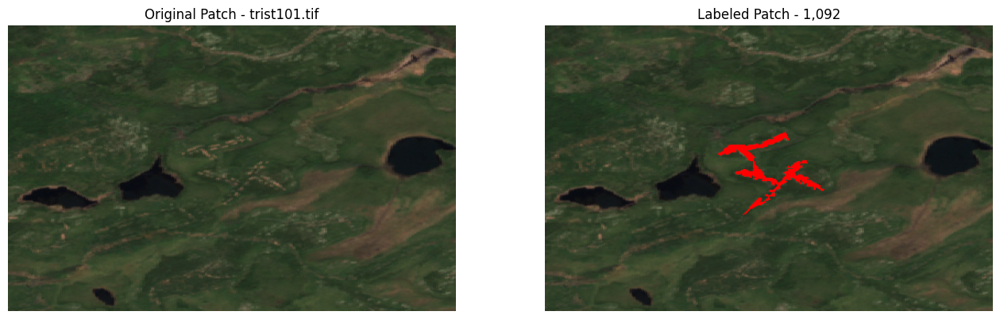

...

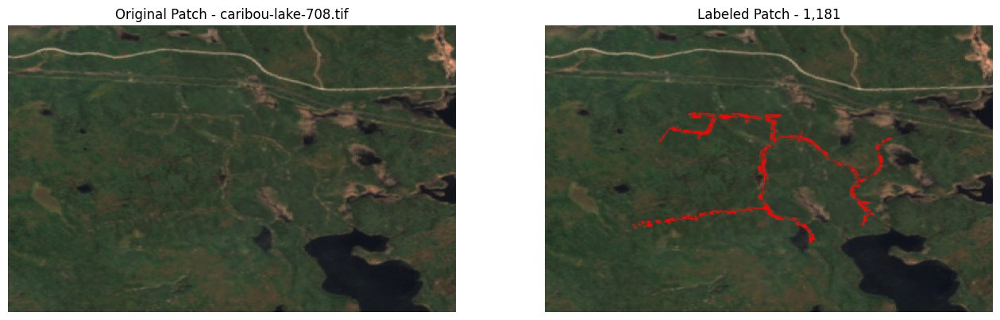

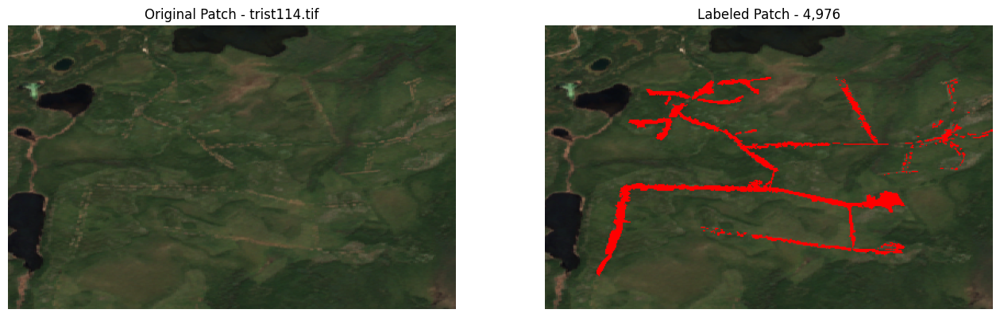

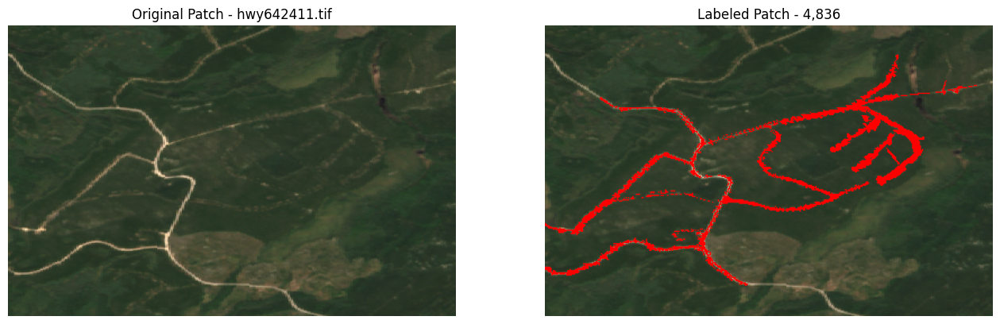

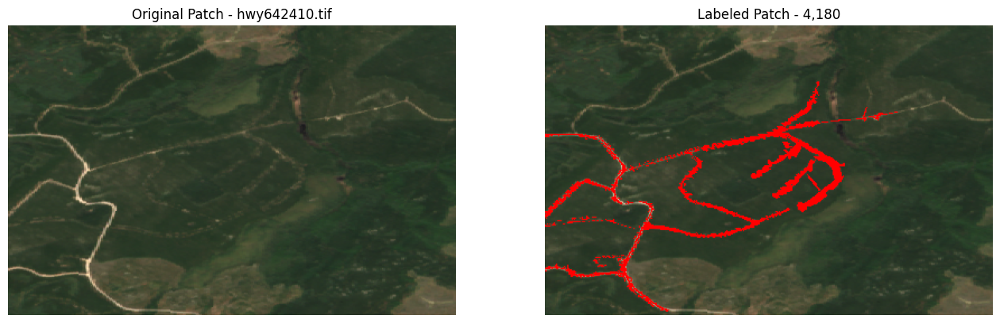

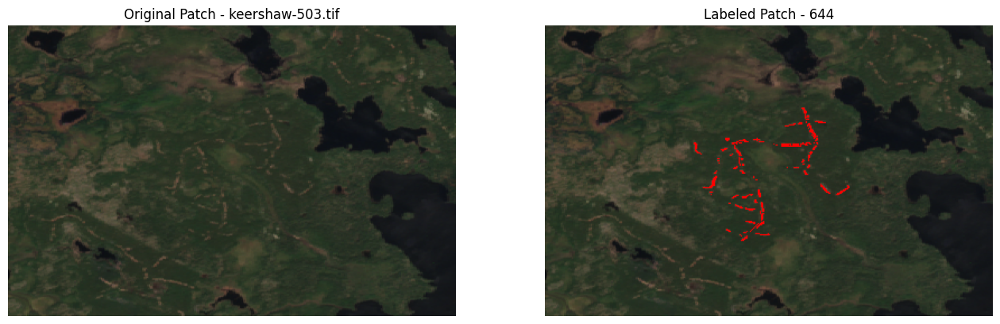

In [86]:
# Reading the patches
patch_image_dir = f'/content/dataset/image/'
patch_mask_dir = f'/content/dataset/mask/'

tiles = []
for subdir, dirs, files in os.walk(patch_image_dir):
    for f in files:
        if isfile(join(patch_image_dir, f)) and '.tif' in f:
            tiles.append([join(patch_image_dir, f), join(patch_mask_dir, f)])

count = 0
for t in tiles:
    with rasterio.open(t[1]) as src:
        mask = src.read(1)

    fig, ax = plt.subplots(1, 2, figsize=(16, 12))
    [img, xsize, ysize, nbands] = loadTiff(t[0], 0.2)
    img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2]))
    # Create a red color overlay using the mask
    overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    overlay[..., 0] = 1  # Red channel
    overlay[..., 3] = mask

    mask_file_name = os.path.basename(t[0]).split('_')[1]

    # Display the original image and the masked image
    ax[0].imshow(img_rgb)
    ax[0].set_title(f'Original Patch - {mask_file_name}')
    ax[0].axis('off')

    ax[1].imshow(img_rgb, cmap='gray')
    ax[1].imshow(overlay)
    ax[1].set_title(f'Labeled Patch - {mask.sum():,}')
    ax[1].axis('off')

    plt.show()

# Dataset View - ~512
An image with ~512px dimention

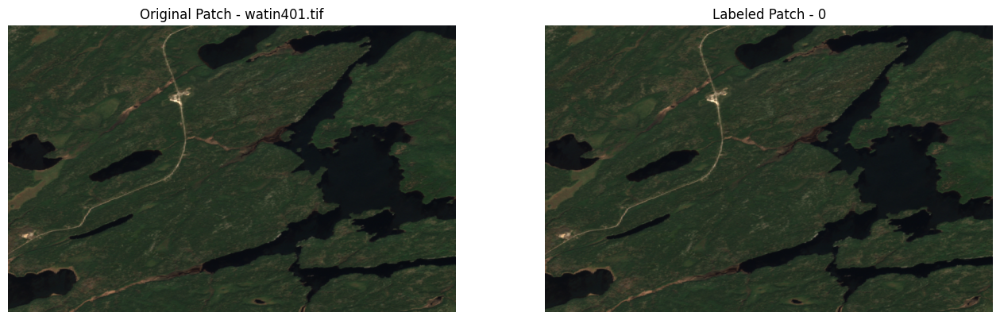

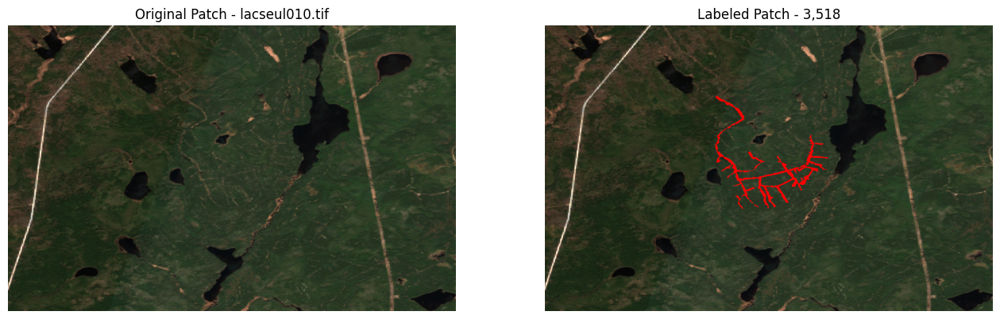

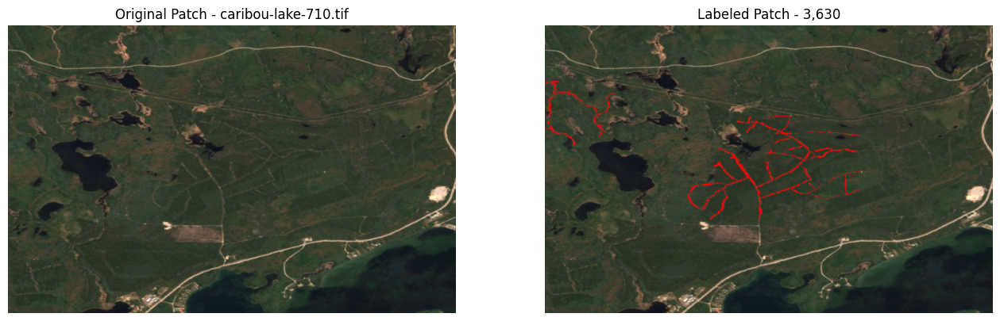

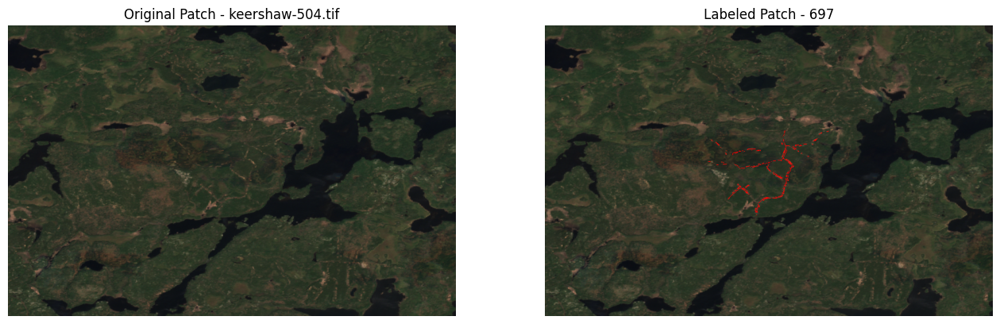

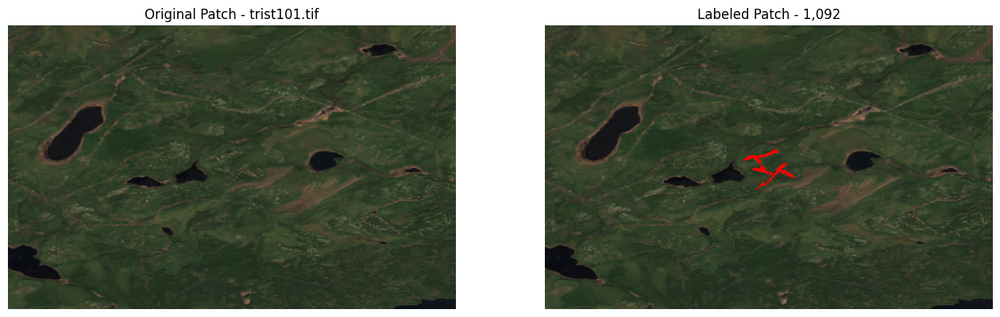

...

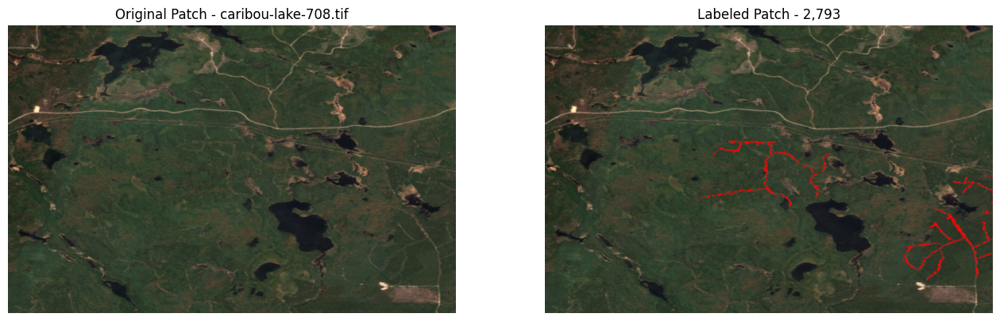

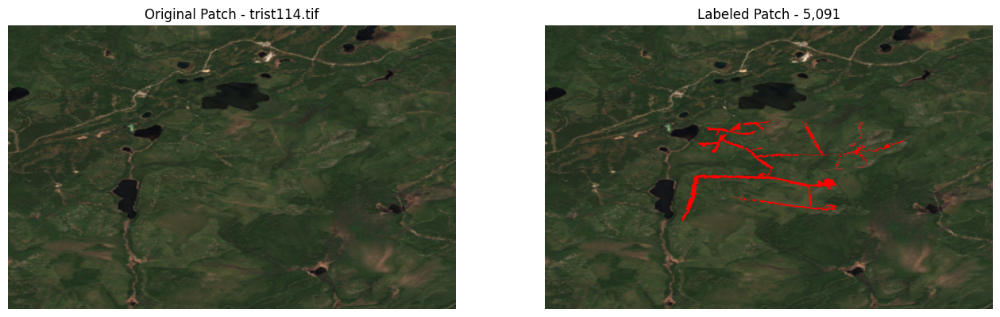

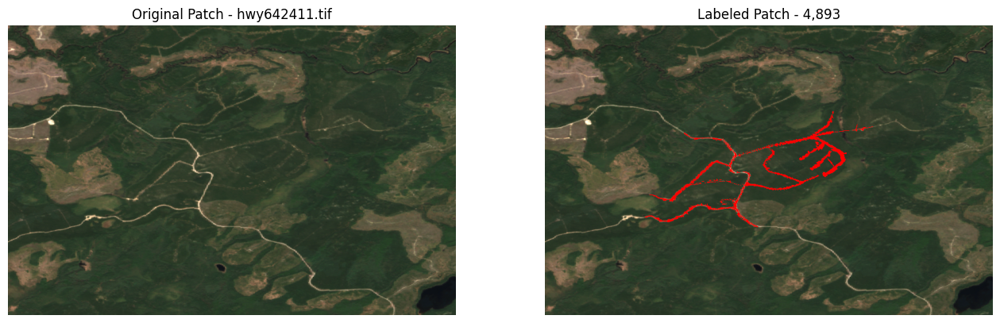

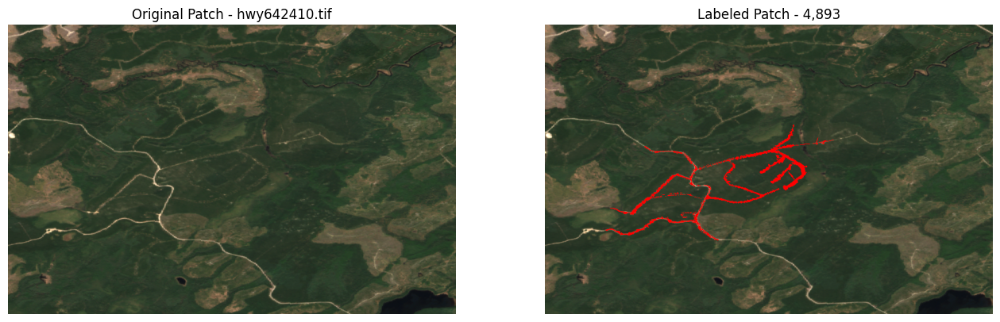

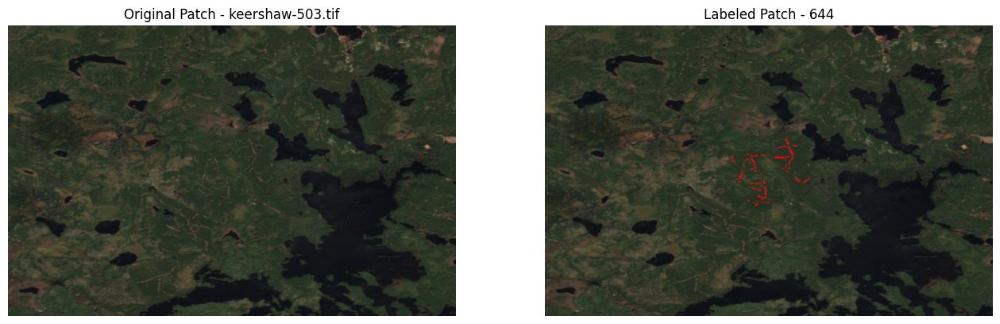

In [75]:
# Reading the patches
patch_image_dir = f'/content/dataset/image/'
patch_mask_dir = f'/content/dataset/mask/'

tiles = []
for subdir, dirs, files in os.walk(patch_image_dir):
    for f in files:
        if isfile(join(patch_image_dir, f)) and '.tif' in f:
            tiles.append([join(patch_image_dir, f), join(patch_mask_dir, f)])

count = 0
for t in tiles:
    with rasterio.open(t[1]) as src:
        mask = src.read(1)

    fig, ax = plt.subplots(1, 2, figsize=(16, 12))
    [img, xsize, ysize, nbands] = loadTiff(t[0], 0.2)
    img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2]))
    # Create a red color overlay using the mask
    overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    overlay[..., 0] = 1  # Red channel
    overlay[..., 3] = mask

    mask_file_name = os.path.basename(t[0]).split('_')[1]

    # Display the original image and the masked image
    ax[0].imshow(img_rgb)
    ax[0].set_title(f'Original Patch - {mask_file_name}')
    ax[0].axis('off')

    ax[1].imshow(img_rgb, cmap='gray')
    ax[1].imshow(overlay)
    ax[1].set_title(f'Labeled Patch - {mask.sum():,}')
    ax[1].axis('off')

    plt.show()

## Upload Dataset
You can move the generated dataset to Google Drive to use it later for training


In [ ]:
# Change the destination directory name
!cp -rn {dataset_dir} /content/drive/MyDrive/in_house_boreal_dataset